In [ ]:
!pip install requests tqdm
import requests
from tqdm import tqdm

url = "http://images.cocodataset.org/zips/train2017.zip"
response = requests.get(url, stream=True)
total_size = int(response.headers.get('content-length', 0))
chunk_size = 1024 * 1024 # 1 MB
with open("train2017.zip", "wb") as f:
    # Indent the for loop to be within the 'with' block
    for data in tqdm(response.iter_content(chunk_size), total=total_size // chunk_size, unit='MB'):
        f.write(data)

18442MB [20:02, 15.34MB/s]                           


In [ ]:
# ==================================
# CELL 1: GAN Attempt - Setup & Imports
# ==================================
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

import os
import zipfile
import glob
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import random

print("Libraries imported.")

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Set random seed for reproducibility (optional)
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
if device.type == 'cuda':
    torch.cuda.manual_seed_all(manualSeed)

Libraries imported.
Using device: cuda
Random Seed:  999


In [ ]:
# ==================================
# CELL 2: GAN Attempt - Unzip COCO Data
# ==================================
import time

zip_file_path = 'train2017.zip'
extract_dir = 'coco_images' # Directory to store unzipped images
image_dir = os.path.join(extract_dir, 'train2017') # Images are usually inside a subfolder

if not os.path.exists(zip_file_path):
    print(f"ERROR: {zip_file_path} not found. Please upload it first.")
else:
    if os.path.exists(image_dir):
        print(f"Image directory '{image_dir}' already exists. Assuming already unzipped.")
    else:
        print(f"Found {zip_file_path}. Starting extraction to '{extract_dir}'...")
        start_time = time.time()
        try:
            with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
                zip_ref.extractall(extract_dir)
            end_time = time.time()
            print(f"Successfully extracted zip file in {end_time - start_time:.2f} seconds.")
            if os.path.exists(image_dir):
                 print(f"Images should be in: {image_dir}")
            else:
                 print(f"Warning: Expected image subfolder '{image_dir}' not found after extraction. Check contents.")
        except Exception as e:
            print(f"ERROR: Failed to extract zip file: {e}")

# Verify image directory exists before proceeding
if not os.path.exists(image_dir):
     print(f"\n*** ERROR: Image directory '{image_dir}' does not exist. Cannot proceed with data loading. ***")
     # Stop execution or handle error appropriately
     # For now, we'll just print the error. Further cells might fail.

Found train2017.zip. Starting extraction to 'coco_images'...
Successfully extracted zip file in 52.60 seconds.
Images should be in: coco_images/train2017


Looking for images in: coco_images/train2017
Found 118287 total images, using 10000.
Dataset and DataLoader created.


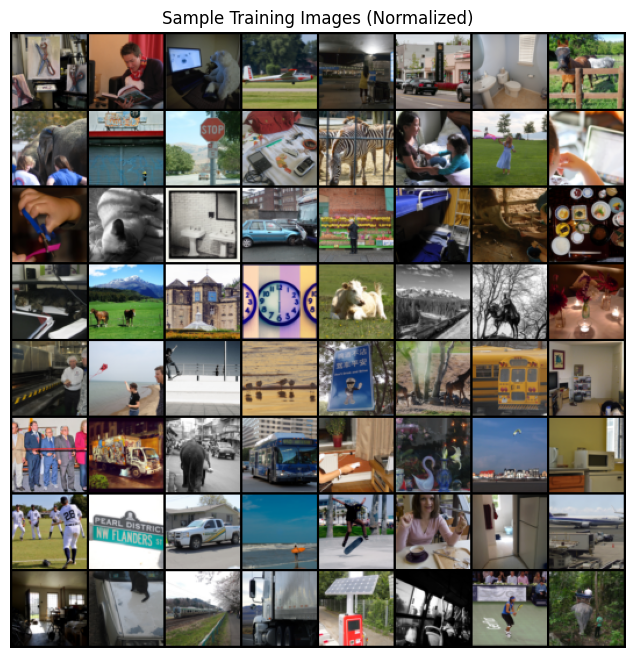

In [ ]:
# ==================================
# CELL 3: Data Preparation
# ==================================

# --- Parameters ---
image_folder_path = "coco_images/train2017" # Path defined in Cell 2
image_size = 64 # Desired image size (must match GAN architecture)
batch_size = 128 # How many images to process at once
num_images_to_use = 10000 # Number of images to load from COCO (adjust as needed/possible)
workers = 2 # Number of parallel workers for loading data

# --- Define Transformations ---
# Resize, crop to square, convert to Tensor, normalize pixel values to [-1, 1]
transform=transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # Normalize to [-1, 1]
])

# --- Custom Dataset Class ---
class CocoDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        """
        Args:
            image_paths (list): List of paths to the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        try:
            # Open image, convert to RGB (handles grayscale automatically)
            image = Image.open(img_path).convert('RGB')
            if self.transform:
                image = self.transform(image)
            return image
        except Exception as e:
            # Handle cases where an image might be corrupt
            # print(f"Warning: Could not load image {img_path}. Error: {e}. Skipping.")
            # For simplicity here, let's return the 0th image if loading fails
            # A better approach might be needed for robust training
            try:
                 image = Image.open(self.image_paths[0]).convert('RGB')
                 if self.transform:
                      image = self.transform(image)
                 return image
            except: # If even the 0th image fails
                 return torch.zeros((3, image_size, image_size), dtype=torch.float) # Return black image tensor

# --- Create Dataset and DataLoader ---
# Check if the target image folder exists
if os.path.isdir(image_folder_path):
    print(f"Looking for images in: {image_folder_path}")
    # Find all jpg images, limit to num_images_to_use
    all_image_paths = sorted(glob.glob(os.path.join(image_folder_path, "*.jpg")))
    selected_image_paths = all_image_paths[:num_images_to_use]

    if len(selected_image_paths) > 0:
        print(f"Found {len(all_image_paths)} total images, using {len(selected_image_paths)}.")
        # Create the dataset
        coco_dataset = CocoDataset(image_paths=selected_image_paths, transform=transform)
        # Create the dataloader
        # Adjust num_workers based on your Colab instance if needed
        dataloader = DataLoader(coco_dataset, batch_size=batch_size,
                                shuffle=True, num_workers=workers, pin_memory=True)
        print("Dataset and DataLoader created.")

        # Optional: Plot some training images
        try:
            real_batch = next(iter(dataloader))
            plt.figure(figsize=(8,8))
            plt.axis("off")
            plt.title("Sample Training Images (Normalized)")
            # Display using make_grid. Normalize=True scales images to [0,1] for display
            plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
            plt.show()
        except StopIteration:
            print("Could not retrieve a batch from DataLoader (maybe dataset is empty or batch size is too large?).")
        except Exception as e:
            print(f"Error displaying sample batch: {e}")

    else:
        print(f"ERROR: No images found in {image_folder_path}. Cannot create dataset.")
        dataloader = None # Set dataloader to None to prevent errors later
else:
    print(f"ERROR: Image folder path '{image_folder_path}' does not exist. Cannot create dataset.")
    dataloader = None

In [ ]:
# ==================================
# CELL 4: Define GAN Architecture
# ==================================

# Size of z latent vector (generator input noise)
nz = 100
# Number of channels in the training images (3 for RGB)
nc = 3
# Size of feature maps in generator
ngf = 64
# Size of feature maps in discriminator
ndf = 64

# --- Generator ---
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False), # Output: (ngf*8) x 4 x 4
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False), # Output: (ngf*4) x 8 x 8
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False), # Output: (ngf*2) x 16 x 16
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False), # Output: (ngf) x 32 x 32
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False), # Output: (nc) x 64 x 64
            nn.Tanh() # Output range [-1, 1] to match normalized image data
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        # Reshape input noise if it's just a flat vector
        if input.dim() == 2:
             input = input.unsqueeze(-1).unsqueeze(-1) # Make it (batch_size, nz, 1, 1)
        return self.main(input)

# --- Discriminator ---
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False), # Output: (ndf) x 32 x 32
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False), # Output: (ndf*2) x 16 x 16
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False), # Output: (ndf*4) x 8 x 8
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False), # Output: (ndf*8) x 4 x 4
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False), # Output: 1 x 1 x 1 (scalar probability)
            nn.Sigmoid() # Output probability [0, 1]
        )

    def forward(self, input):
        # Flatten the output to a single probability per image in the batch
        return self.main(input).view(-1)

# --- Initialize Models ---
# Use device defined in Cell 1
netG = Generator().to(device)
netD = Discriminator().to(device)

# Optional: Apply custom weight initialization (common practice for GANs)
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

netG.apply(weights_init)
netD.apply(weights_init)

print("Generator and Discriminator models defined and initialized.")
# Optional: Print model structure
# print(netG)
# print(netD)

Generator and Discriminator models defined and initialized.


In [ ]:
# ==================================
# CELL 5: Training Setup
# ==================================
import time # Import time for epoch timing

# Loss function
criterion = nn.BCELoss() # Binary Cross Entropy Loss

# Create batch of latent vectors to visualize generator progress
# Use the noise dimension 'nz' defined in Cell 4
fixed_noise = torch.randn(64, nz, 1, 1, device=device) # 64 images, noise dim nz

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
# Learning rate and Beta1 hyperparameter (common values for GANs)
lr = 0.0002
beta1 = 0.5

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

print("Loss function, fixed noise, and optimizers set up.")

Loss function, fixed noise, and optimizers set up.


Starting Training Loop...
Will train for 15 epochs.
[1/15][0/79]	Loss_D: 1.6541	Loss_G: 6.9763	D(x): 0.7333	D(G(z)): 0.6395 / 0.0020

---> Images generated after Epoch 1/15 (Loss_D: 0.0176 | Loss_G: 4.5192) <---


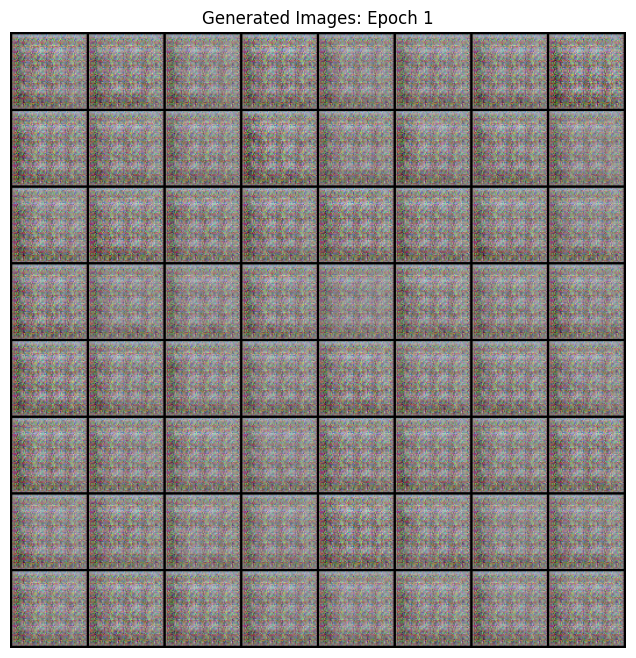

---> Epoch 1 completed in 26.97 seconds.

[2/15][0/79]	Loss_D: 0.7813	Loss_G: 13.9486	D(x): 0.9778	D(G(z)): 0.5126 / 0.0000

---> Images generated after Epoch 2/15 (Loss_D: 1.0575 | Loss_G: 4.6426) <---


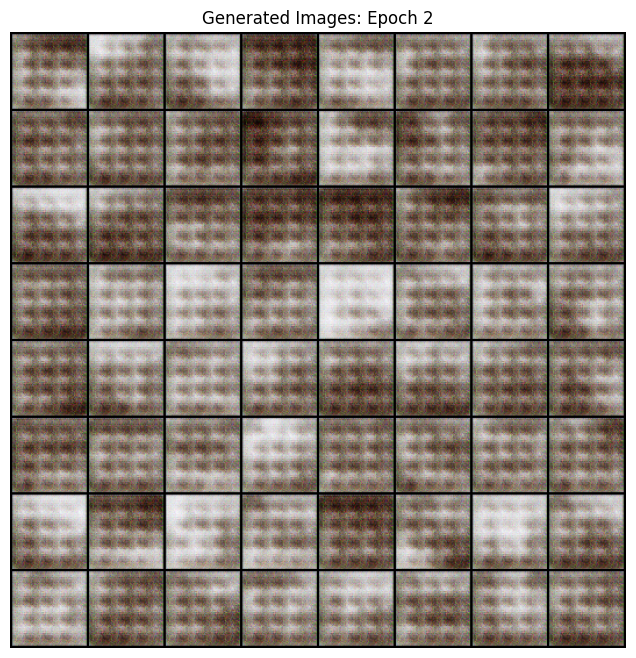

---> Epoch 2 completed in 26.33 seconds.

[3/15][0/79]	Loss_D: 0.9820	Loss_G: 2.9302	D(x): 0.6205	D(G(z)): 0.2052 / 0.0758

---> Images generated after Epoch 3/15 (Loss_D: 0.1600 | Loss_G: 4.7342) <---


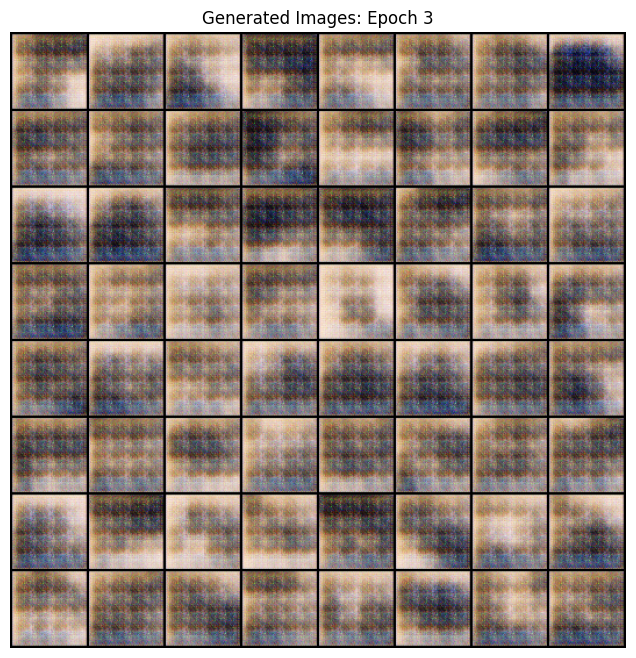

---> Epoch 3 completed in 26.29 seconds.

[4/15][0/79]	Loss_D: 0.3353	Loss_G: 6.1524	D(x): 0.9609	D(G(z)): 0.2091 / 0.0056

---> Images generated after Epoch 4/15 (Loss_D: 0.7506 | Loss_G: 2.6610) <---


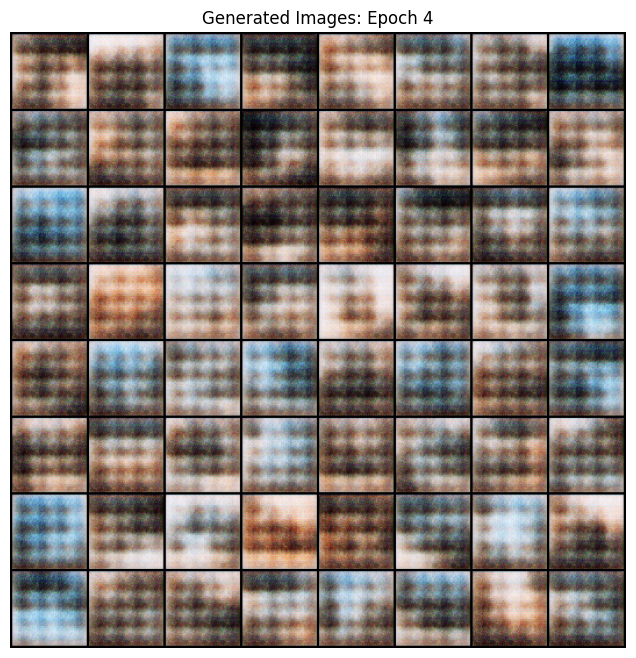

---> Epoch 4 completed in 26.24 seconds.

[5/15][0/79]	Loss_D: 1.0109	Loss_G: 5.8284	D(x): 0.9048	D(G(z)): 0.5425 / 0.0045

---> Images generated after Epoch 5/15 (Loss_D: 0.1868 | Loss_G: 3.0092) <---


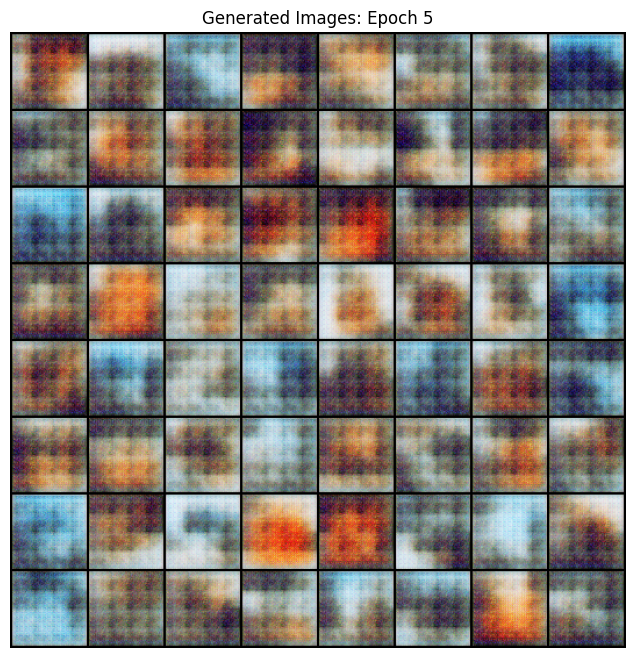

---> Epoch 5 completed in 26.05 seconds.

[6/15][0/79]	Loss_D: 0.6405	Loss_G: 5.2292	D(x): 0.9370	D(G(z)): 0.3785 / 0.0080

---> Images generated after Epoch 6/15 (Loss_D: 0.2093 | Loss_G: 3.6208) <---


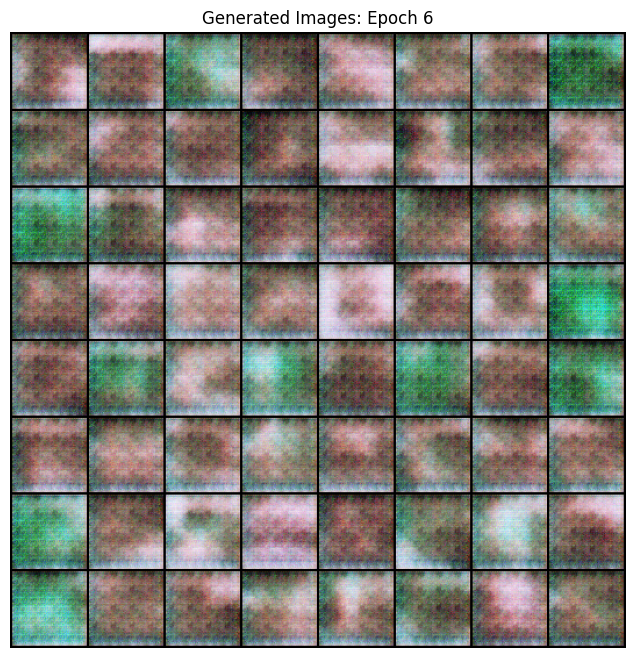

---> Epoch 6 completed in 26.02 seconds.

[7/15][0/79]	Loss_D: 0.7676	Loss_G: 8.6614	D(x): 0.8890	D(G(z)): 0.4092 / 0.0004

---> Images generated after Epoch 7/15 (Loss_D: 0.1616 | Loss_G: 5.1948) <---


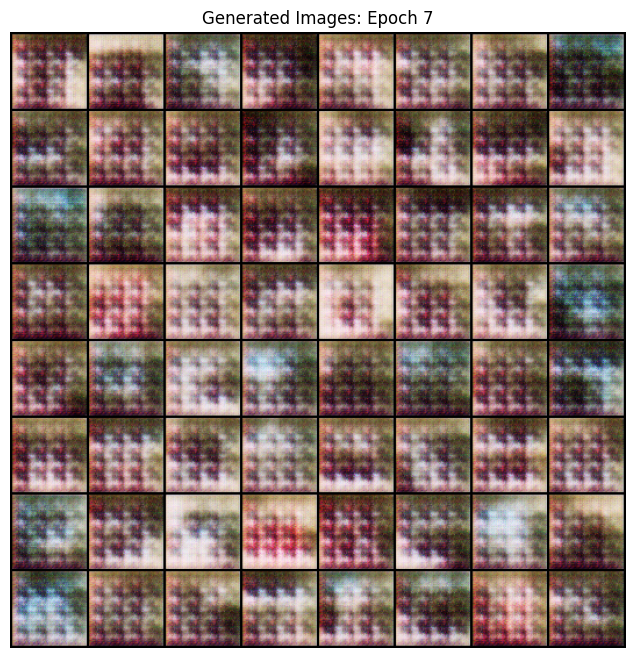

---> Epoch 7 completed in 26.04 seconds.

[8/15][0/79]	Loss_D: 0.3547	Loss_G: 4.1413	D(x): 0.8360	D(G(z)): 0.1135 / 0.0214

---> Images generated after Epoch 8/15 (Loss_D: 0.3855 | Loss_G: 3.4993) <---


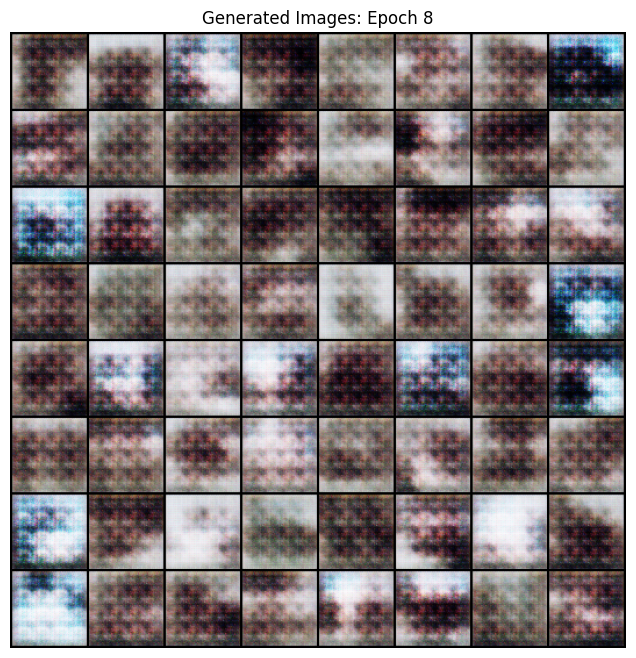

---> Epoch 8 completed in 26.44 seconds.

[9/15][0/79]	Loss_D: 0.6986	Loss_G: 2.0935	D(x): 0.6701	D(G(z)): 0.1668 / 0.1718

---> Images generated after Epoch 9/15 (Loss_D: 3.3107 | Loss_G: 1.6695) <---


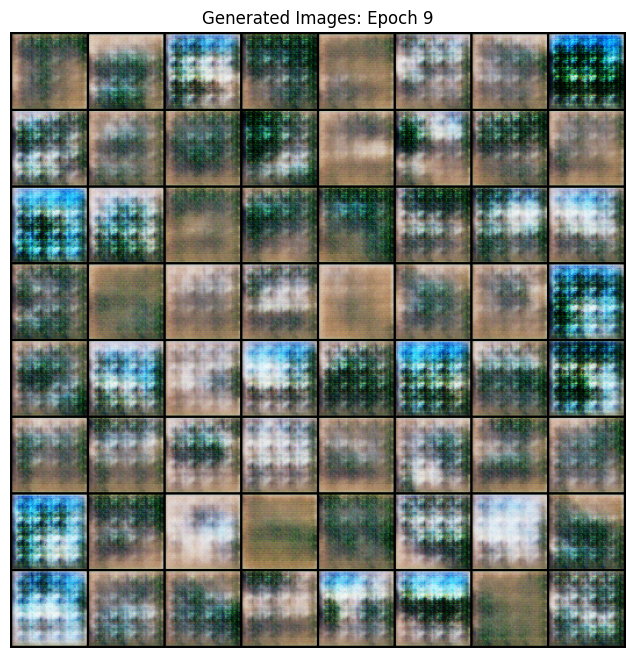

---> Epoch 9 completed in 26.10 seconds.

[10/15][0/79]	Loss_D: 2.7815	Loss_G: 6.9699	D(x): 0.9321	D(G(z)): 0.7862 / 0.0139

---> Images generated after Epoch 10/15 (Loss_D: 0.3424 | Loss_G: 4.8028) <---


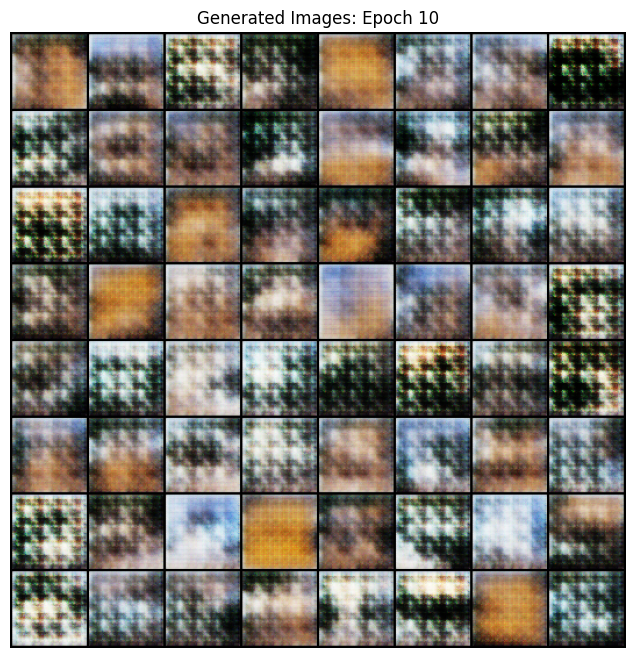

---> Epoch 10 completed in 26.20 seconds.

[11/15][0/79]	Loss_D: 0.6702	Loss_G: 5.5173	D(x): 0.8071	D(G(z)): 0.2776 / 0.0064

---> Images generated after Epoch 11/15 (Loss_D: 0.8612 | Loss_G: 12.8818) <---


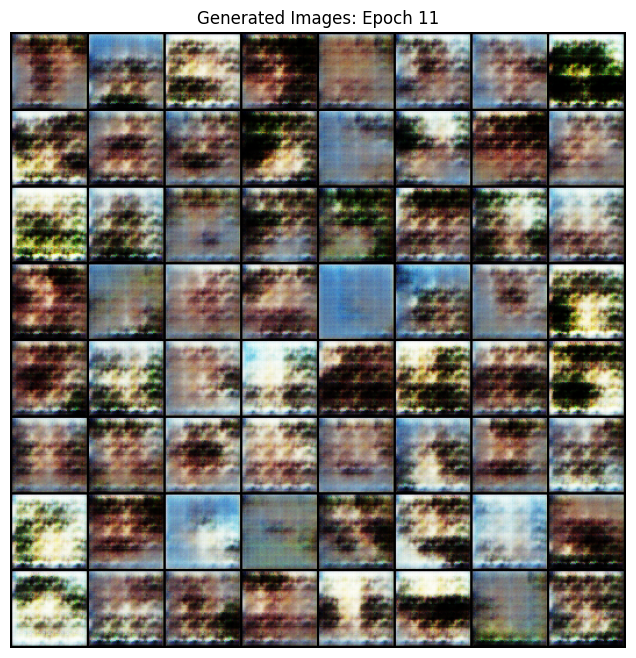

---> Epoch 11 completed in 26.28 seconds.

[12/15][0/79]	Loss_D: 2.4356	Loss_G: 5.6295	D(x): 0.2027	D(G(z)): 0.0002 / 0.0193

---> Images generated after Epoch 12/15 (Loss_D: 0.2496 | Loss_G: 3.7394) <---


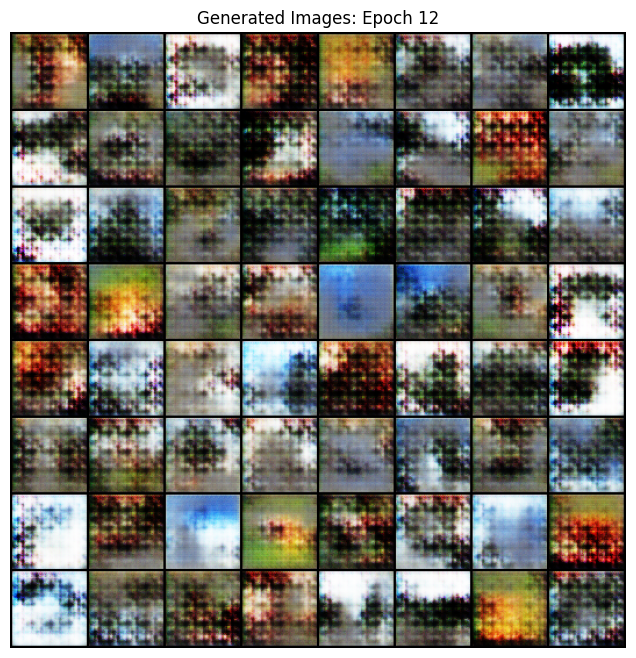

---> Epoch 12 completed in 26.30 seconds.

[13/15][0/79]	Loss_D: 1.1298	Loss_G: 6.0148	D(x): 0.8177	D(G(z)): 0.5305 / 0.0064

---> Images generated after Epoch 13/15 (Loss_D: 1.1275 | Loss_G: 8.4184) <---


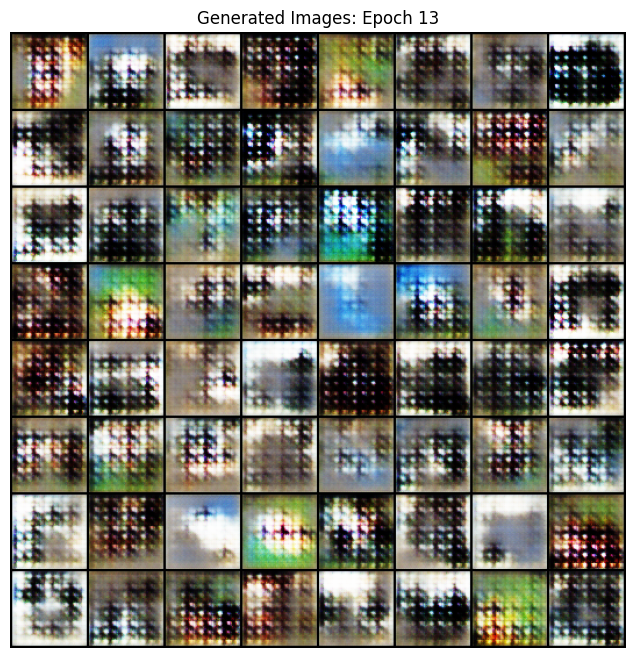

---> Epoch 13 completed in 26.27 seconds.

[14/15][0/79]	Loss_D: 1.0275	Loss_G: 3.4554	D(x): 0.5057	D(G(z)): 0.0918 / 0.0954

---> Images generated after Epoch 14/15 (Loss_D: 0.6787 | Loss_G: 8.3831) <---


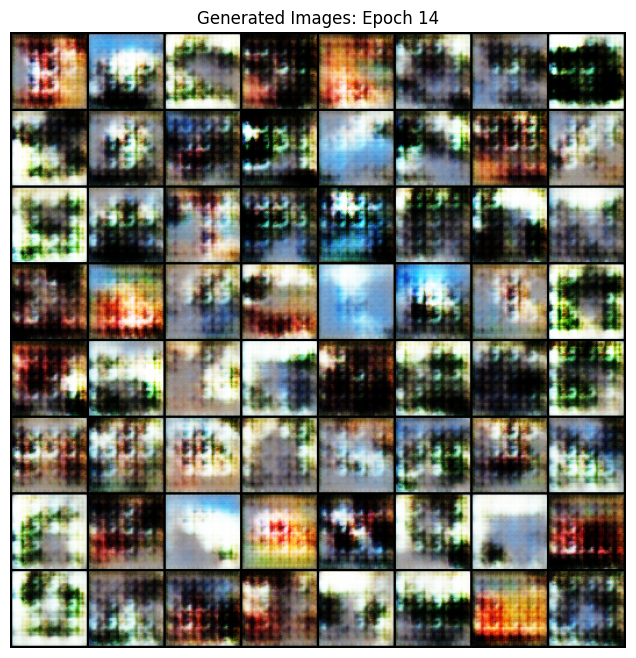

---> Epoch 14 completed in 26.17 seconds.

[15/15][0/79]	Loss_D: 0.5269	Loss_G: 3.9631	D(x): 0.6784	D(G(z)): 0.0298 / 0.0513

---> Images generated after Epoch 15/15 (Loss_D: 0.6377 | Loss_G: 2.9923) <---


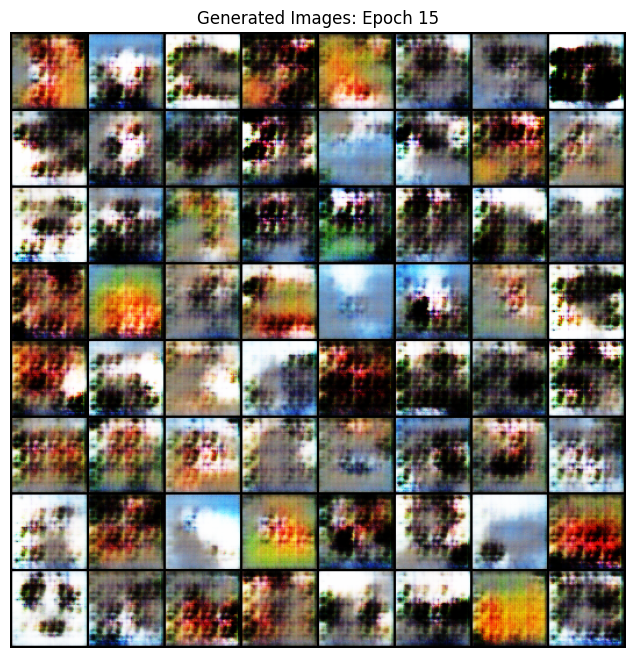

---> Epoch 15 completed in 26.45 seconds.

--- Training Finished ---


In [ ]:
# ==================================
# CELL 6: GAN Training Loop
# ==================================

# --- Training Hyperparameters ---
num_epochs = 15 # Set number of training epochs (e.g., 10-20 is reasonable for a demo)

# --- Lists to keep track of progress ---
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
print(f"Will train for {num_epochs} epochs.")

# Check if dataloader exists and is not None (from Cell 3)
if 'dataloader' in locals() and dataloader is not None:
    for epoch in range(num_epochs):
        epoch_start_time = time.time()
        # For each batch in the dataloader
        for i, data in enumerate(dataloader, 0):

            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            ## Train with all-real batch
            netD.zero_grad()
            # Format batch
            real_cpu = data.to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            # Forward pass real batch through D
            output = netD(real_cpu) # .view(-1) is now done in model's forward
            # Calculate loss on all-real batch
            errD_real = criterion(output, label)
            # Calculate gradients for D in backward pass
            errD_real.backward()
            D_x = output.mean().item() # Average D output for real images

            ## Train with all-fake batch
            # Generate batch of latent vectors
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            # Generate fake image batch with G
            fake = netG(noise)
            label.fill_(fake_label)
            # Classify all fake batch with D
            # Use .detach() so gradients don't flow back to G during D update
            output = netD(fake.detach()) # .view(-1) is now done in model's forward
            # Calculate D's loss on the all-fake batch
            errD_fake = criterion(output, label)
            # Calculate the gradients for this batch, accumulated with previous gradients
            errD_fake.backward()
            D_G_z1 = output.mean().item() # Average D output for fake images (before D update)
            # Compute error of D as sum over the fake and the real batches
            errD = errD_real + errD_fake
            # Update D
            optimizerD.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            netG.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = netD(fake) # .view(-1) is now done in model's forward
            # Calculate G's loss based on this output (how well it fooled D)
            errG = criterion(output, label)
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item() # Average D output for fake images (after D update, used to train G)
            # Update G
            optimizerG.step()

            # Output training stats periodically
            if i % 100 == 0: # Print every 100 batches
                print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                      % (epoch+1, num_epochs, i, len(dataloader),
                         errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())
            iters += 1

        # After each epoch, generate and save images using fixed_noise
        with torch.no_grad():
            fake_samples = netG(fixed_noise).detach().cpu()
        grid = vutils.make_grid(fake_samples, padding=2, normalize=True)
        img_list.append(grid)

        # Display the generated images for this epoch
        print(f"\n---> Images generated after Epoch {epoch+1}/{num_epochs} (Loss_D: {errD.item():.4f} | Loss_G: {errG.item():.4f}) <---")
        plt.figure(figsize=(8,8))
        plt.axis("off")
        plt.title(f"Generated Images: Epoch {epoch+1}")
        plt.imshow(np.transpose(grid,(1,2,0)))
        plt.show()

        epoch_end_time = time.time()
        print(f"---> Epoch {epoch+1} completed in {epoch_end_time - epoch_start_time:.2f} seconds.\n")


    print("--- Training Finished ---")

else:
    print("ERROR: DataLoader was not created successfully in Cell 3. Cannot start training.")


# Optional: Plot loss curves after training
# plt.figure(figsize=(10,5))
# plt.title("Generator and Discriminator Loss During Training")
# plt.plot(G_losses,label="G")
# plt.plot(D_losses,label="D")
# plt.xlabel("iterations")
# plt.ylabel("Loss")
# plt.legend()
# plt.show()

In [1]:
# ==================================
# CELL 1: SETUP & PRE-CHECKS (v2)
# ==================================

# 1. INSTALL NECESSARY PACKAGES (quietly)
print("Installing required libraries...")
!pip install ultralytics -q
# Ensure transformers is compatible, potentially specifying a version if needed
!pip install transformers torch torchvision torchaudio accelerate Pillow sentencepiece -q
print("Libraries installed.")

# 2. IMPORT LIBRARIES
import torch
import os
import json
import warnings
from ultralytics import YOLO
# Import specific classes for explicit BLIP loading
from transformers import BlipProcessor, BlipForConditionalGeneration
from PIL import Image

# 3. SETUP & CONFIGURATION
print("Setting up...")
# Suppress common warnings
warnings.filterwarnings('ignore')

# Set device to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# --- !!! USER CONFIGURATION REQUIRED BELOW !!! ---
# List of your EXACT image filenames uploaded to Colab
# WARNING: Filenames with spaces can sometimes cause issues. Use underscores if possible.
# WARNING: Ensure filename CASE matches exactly what you uploaded (Linux is case-sensitive).
image_files = [
    'image 1 object detection.jpg',
    'image 2 object detection.jpg',
    'image 3 object detection.jpg',
    'image 4 object detection.jpg',
    'image 5 object detection.jpg'
    # Double-check spelling, spacing, and extensions (.jpg, .png, etc.)
]
# --- !!! END OF USER CONFIGURATION !!! ---

# Directory to store all outputs
output_dir = 'project_results'
os.makedirs(output_dir, exist_ok=True)
print(f"Output directory created/exists: {output_dir}")

# 4. PRE-RUN FILE CHECK
print("\nChecking if all specified image files exist...")
all_files_found = True
for fname in image_files:
    if not os.path.exists(fname):
        print(f"  ERROR: File not found - '{fname}'. Please upload it correctly and check the filename/case in the script.")
        all_files_found = False

if not all_files_found:
    print("\n*** WARNING: One or more input image files are missing. Part A execution will be skipped. ***")
else:
    print("  All specified image files found. Ready to proceed.")

Installing required libraries...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 62.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 38.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 101.6 MB/s eta 0:00:00
Libraries installed.
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Se

In [2]:
# ==================================
# CELL 2: DEFINE PART A FUNCTION (v2 - Improved + Inline Display)
# ==================================
# Import necessary display/plotting libraries
import matplotlib.pyplot as plt
from IPython.display import display, clear_output # To manage display in loops
from PIL import Image # Make sure PIL is imported here too

# --- Re-define the run_part_a function ---
def run_part_a(image_paths, results_dir, detection_model_name='yolov8n.pt', caption_model_name='Salesforce/blip-image-captioning-base'):
    """
    Runs object detection (YOLOv8) and image captioning (BLIP - explicit load)
    on a list of images. Validates images first.
    Displays Original vs. Detected images inline using matplotlib.
    Saves detected images and a JSON summary.

    Args:
        image_paths (list): List of paths to input image files.
        results_dir (str): Directory to save output images and JSON results.
        detection_model_name (str): Name of the YOLO model to use.
        caption_model_name (str): Name of the Hugging Face captioning model.

    Returns:
        dict: A dictionary containing results for each image, or None if critical error occurs.
    """
    print("\n--- Defining Part A Processing Logic (v2 + Display) ---")
    part_a_results = {}
    detection_results_dir = os.path.join(results_dir, 'detected_images')
    os.makedirs(detection_results_dir, exist_ok=True)

    # --- Object Detection Setup ---
    print(f"\n  Preparing Object Detection model ({detection_model_name})...")
    detection_model = None
    try:
        # Load model and explicitly move to device (device defined in Cell 1)
        detection_model = YOLO(detection_model_name).to(device)
        print(f"    Object Detection model loaded successfully onto device: {device}.")
    except Exception as e:
        print(f"    ERROR: Failed to load detection model: {e}")
        print("    Object Detection will be skipped.")

    # --- Image Captioning Setup (Explicit BLIP Load) ---
    print(f"\n  Preparing Image Captioning model ({caption_model_name})...")
    caption_processor = None
    caption_model = None
    try:
        # Use device defined in Cell 1
        caption_processor = BlipProcessor.from_pretrained(caption_model_name)
        caption_model = BlipForConditionalGeneration.from_pretrained(caption_model_name).to(device)
        print(f"    Image Captioning processor and model loaded successfully onto device: {device}.")
    except Exception as e:
        print(f"    ERROR: Failed to load captioning processor/model: {e}")
        print("    Image Captioning will be skipped.")

    # --- Processing Loop ---
    print("\n  Starting Image Processing Loop...")
    for img_path in image_paths:
        base_filename = os.path.basename(img_path)
        part_a_results[base_filename] = {} # Initialize entry
        print(f"\n---------------------\n    Processing {img_path}...\n---------------------")

        # Basic Image Validation
        raw_image = None # Initialize raw_image
        try:
            img_check = Image.open(img_path)
            img_check.verify() # Check integrity
            img_check.close()
            # Re-open for actual use after verification
            raw_image = Image.open(img_path).convert('RGB')
            print("      Image validated successfully.")
        except Exception as e:
            print(f"      ERROR: Failed to open or validate image {img_path}: {e}")
            part_a_results[base_filename]['validation_error'] = str(e)
            continue # Skip this file

        detected_image = None # Initialize detected_image PIL object
        save_path = None # Initialize save_path

        # Perform Detection (if model loaded)
        if detection_model:
            print("        Running detection...")
            try:
                # Ensure inference runs on the correct device
                results = detection_model.predict(img_path, device=device) # Explicitly pass device
                save_path = os.path.join(detection_results_dir, f"detected_{base_filename}")
                results[0].save(filename=save_path) # save plotted image
                part_a_results[base_filename]['detection_output_image'] = save_path

                # Load the saved detected image for display
                if os.path.exists(save_path):
                     detected_image = Image.open(save_path)

                detected_objects_list = []
                object_counts = {}
                if results[0].boxes is not None and results[0].boxes.cls is not None:
                    detected_names = results[0].names
                    detected_classes = results[0].boxes.cls.tolist()
                    for cls_index in detected_classes:
                        name = detected_names[int(cls_index)]
                        detected_objects_list.append(name)
                        object_counts[name] = object_counts.get(name, 0) + 1
                else:
                     object_counts = {"No objects detected"}

                part_a_results[base_filename]['detected_objects'] = detected_objects_list
                part_a_results[base_filename]['detected_object_counts'] = object_counts
                print(f"        Detection: {object_counts} (results saved to {save_path})")
            except Exception as e:
                print(f"        ERROR detecting objects in {img_path}: {e}")
                part_a_results[base_filename]['detection_error'] = str(e)
        else:
            part_a_results[base_filename]['detection_skipped'] = True
            print("        Detection skipped (model not loaded).")


        # --- Display Original vs Detected (if available) using Matplotlib ---
        print("        Displaying Original vs. Detected Image...")
        fig, axes = plt.subplots(1, 2, figsize=(12, 5)) # Create 1 row, 2 columns for plots

        # Display Original Image
        if raw_image:
            axes[0].imshow(raw_image)
            axes[0].set_title(f"Original: {base_filename}")
            axes[0].axis('off')
        else:
             # This case shouldn't happen if validation worked, but good to handle
             axes[0].set_title(f"Original: Load Failed")
             axes[0].axis('off')

        # Display Detected Image
        if detected_image:
            axes[1].imshow(detected_image)
            axes[1].set_title(f"Detected Output")
            axes[1].axis('off')
        elif detection_model and 'detection_error' in part_a_results[base_filename]:
             axes[1].set_title(f"Detected Output: Error")
             axes[1].text(0.5, 0.5, 'Error during detection', horizontalalignment='center', verticalalignment='center', transform=axes[1].transAxes)
             axes[1].axis('off')
        elif detection_model: # No error, but likely no detections if detected_image is None
             axes[1].set_title(f"Detected Output: No Detections")
             # Optionally display the original image again if no detection output exists
             if raw_image: axes[1].imshow(raw_image)
             axes[1].axis('off')
        else: # Detection was skipped
             axes[1].set_title(f"Detected Output: Skipped")
             axes[1].axis('off')

        plt.tight_layout()
        plt.show() # Display the plot inline in the notebook
        # --- End of Display Code ---


        # Perform Captioning (if model and processor loaded and image validated)
        if caption_model and caption_processor and raw_image:
            print("        Running captioning...")
            try:
                # Process image and generate caption explicitly
                inputs = caption_processor(raw_image, return_tensors="pt").to(device)
                out = caption_model.generate(**inputs, max_new_tokens=50)
                caption = caption_processor.decode(out[0], skip_special_tokens=True).strip()

                part_a_results[base_filename]['generated_caption'] = caption
                print(f"        Generated Caption: '{caption}'")
            except Exception as e:
                print(f"        ERROR generating caption for {img_path}: {e}")
                part_a_results[base_filename]['captioning_error'] = str(e)
                print(f"        Generated Caption: Error")
        elif not raw_image:
            print("        Skipping captioning because original image failed to load.")
            part_a_results[base_filename]['captioning_skipped'] = "Image load failed"
            print(f"        Generated Caption: Skipped")
        else: # Models didn't load
             part_a_results[base_filename]['captioning_skipped'] = True
             print("        Skipping captioning because model/processor failed to load.")
             print(f"        Generated Caption: Skipped")


    # --- Save Part A results to JSON ---
    part_a_json_path = os.path.join(results_dir, 'part_a_results.json')
    print(f"\n  Saving Part A results summary to: {part_a_json_path}")
    try:
        with open(part_a_json_path, 'w') as f:
            json.dump(part_a_results, f, indent=4) # Use indent for readability
        print("    Successfully saved Part A JSON.")
    except Exception as e:
        print(f"    ERROR saving Part A JSON results: {e}")
        return None # Indicate failure

    print("--- Part A Function Defined ---")
    return part_a_results


Starting Final Project Execution (v2)

--- Defining Part A Processing Logic (v2 + Display) ---

  Preparing Object Detection model (yolov8n.pt)...


100%|██████████| 6.25M/6.25M [00:00<00:00, 312MB/s]
Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


    Object Detection model loaded successfully onto device: cuda.

  Preparing Image Captioning model (Salesforce/blip-image-captioning-base)...


preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

    Image Captioning processor and model loaded successfully onto device: cuda.

  Starting Image Processing Loop...

---------------------
    Processing image 1 object detection.jpg...
---------------------
      Image validated successfully.
        Running detection...



model.safetensors:   0%|          | 0.00/990M [00:00<?, ?B/s]

image 1/1 /content/image 1 object detection.jpg: 480x640 1 bicycle, 2 motorcycles, 54.7ms
Speed: 18.3ms preprocess, 54.7ms inference, 329.9ms postprocess per image at shape (1, 3, 480, 640)
        Detection: {'bicycle': 1, 'motorcycle': 2} (results saved to project_results/detected_images/detected_image 1 object detection.jpg)
        Displaying Original vs. Detected Image...


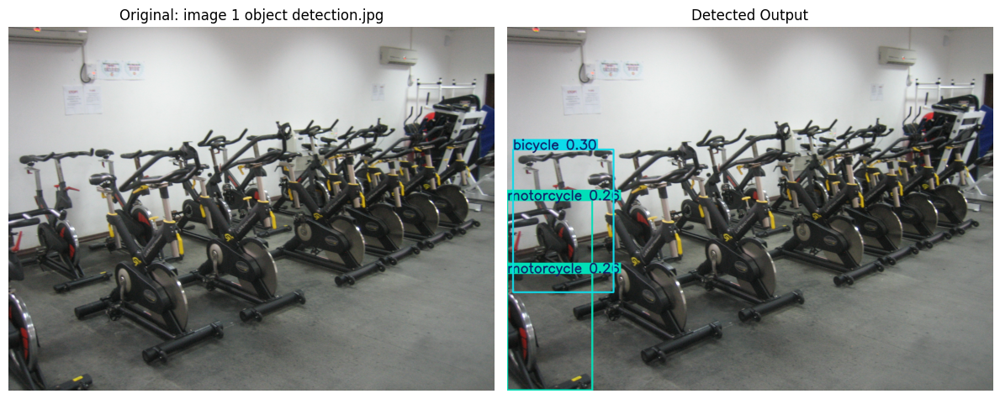

        Running captioning...
        Generated Caption: 'a row of stationary bikes in a gym'

---------------------
    Processing image 2 object detection.jpg...
---------------------
      Image validated successfully.
        Running detection...

image 1/1 /content/image 2 object detection.jpg: 640x448 1 person, 1 tv, 58.8ms
Speed: 3.1ms preprocess, 58.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 448)
        Detection: {'person': 1, 'tv': 1} (results saved to project_results/detected_images/detected_image 2 object detection.jpg)
        Displaying Original vs. Detected Image...


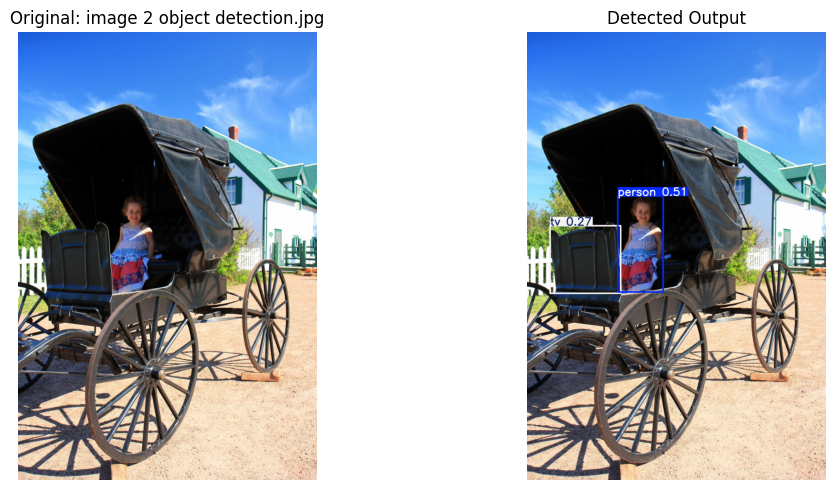

        Running captioning...
        Generated Caption: 'a little girl sitting in a horse drawn carriage'

---------------------
    Processing image 3 object detection.jpg...
---------------------
      Image validated successfully.
        Running detection...

image 1/1 /content/image 3 object detection.jpg: 640x480 (no detections), 53.1ms
Speed: 3.2ms preprocess, 53.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
        Detection: {} (results saved to project_results/detected_images/detected_image 3 object detection.jpg)
        Displaying Original vs. Detected Image...


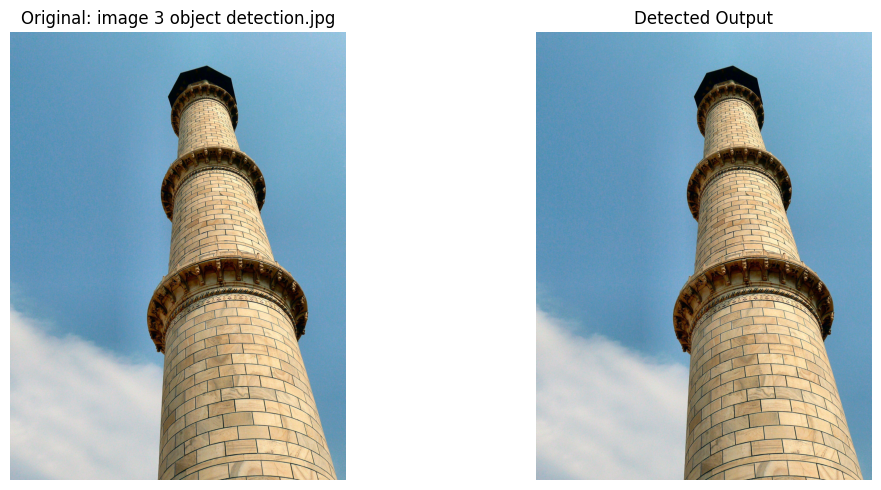

        Running captioning...
        Generated Caption: 'a tall tower with a clock on top'

---------------------
    Processing image 4 object detection.jpg...
---------------------
      Image validated successfully.
        Running detection...

image 1/1 /content/image 4 object detection.jpg: 448x640 1 person, 1 bus, 1 truck, 1 sheep, 53.7ms
Speed: 3.3ms preprocess, 53.7ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)
        Detection: {'sheep': 1, 'truck': 1, 'bus': 1, 'person': 1} (results saved to project_results/detected_images/detected_image 4 object detection.jpg)
        Displaying Original vs. Detected Image...


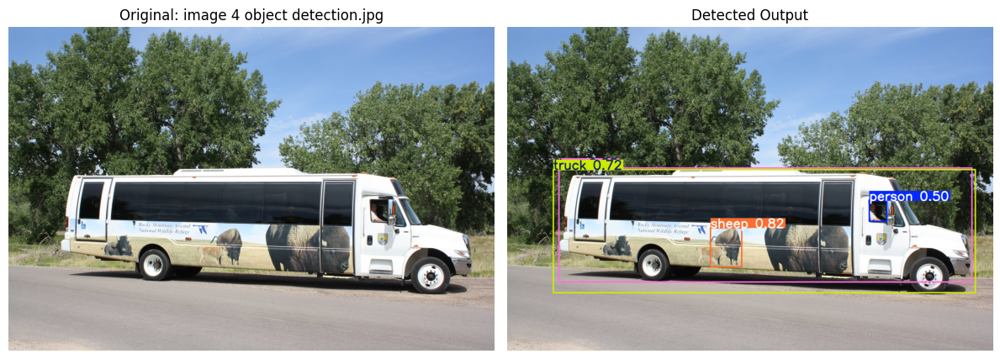

        Running captioning...
        Generated Caption: 'a bus parked on the side of the road'

---------------------
    Processing image 5 object detection.jpg...
---------------------
      Image validated successfully.
        Running detection...

image 1/1 /content/image 5 object detection.jpg: 640x544 1 bird, 53.1ms
Speed: 2.6ms preprocess, 53.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 544)
        Detection: {'bird': 1} (results saved to project_results/detected_images/detected_image 5 object detection.jpg)
        Displaying Original vs. Detected Image...


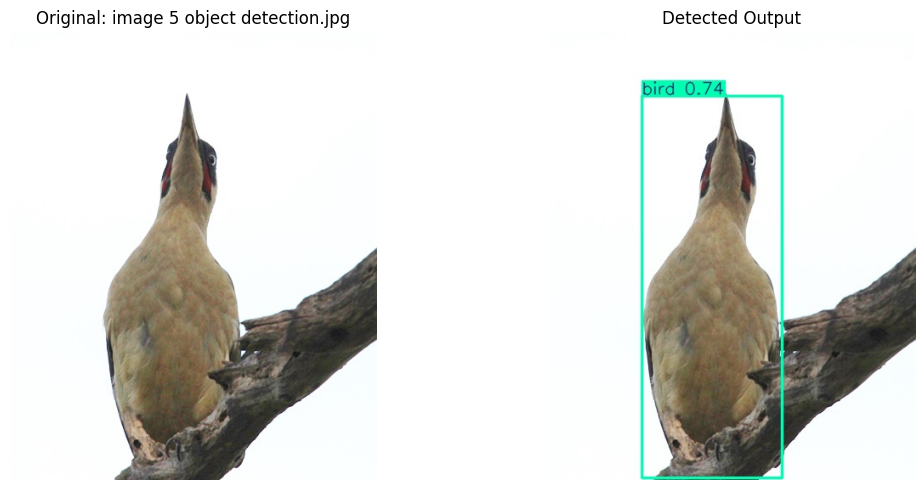

        Running captioning...
        Generated Caption: 'a bird sitting on top of a tree branch'

  Saving Part A results summary to: project_results/part_a_results.json
    Successfully saved Part A JSON.
--- Part A Function Defined ---
ERROR: Part B function 'design_part_b' not defined. Cannot execute Part B.

Project Execution Summary

Part A Status:
  - Successfully processed images (results in JSON/folder).
  - JSON file: project_results/part_a_results.json
  - Detected images folder: project_results/detected_images
  Summary per image (from saved JSON):
    - image 1 object detection.jpg: Objects={'bicycle': 1, 'motorcycle': 2}, Caption='a row of stationary bikes in a gym...'
    - image 2 object detection.jpg: Objects={'person': 1, 'tv': 1}, Caption='a little girl sitting in a horse drawn carriage...'
    - image 3 object detection.jpg: Objects={}, Caption='a tall tower with a clock on top...'
    - image 4 object detection.jpg: Objects={'sheep': 1, 'truck': 1, 'bus': 1, 'perso

In [3]:
# ==================================
# CELL 4: MAIN EXECUTION BLOCK (v2 - Simple)
# ==================================
from IPython.display import display # Ensure display is imported if needed for other parts

if __name__ == "__main__": # Standard practice to check if script is run directly
    print("\n" + "="*80)
    print("Starting Final Project Execution (v2)")
    print("="*80)

    part_a_results_data = None
    part_b_design_data = None

    # Execute Part A only if all files were found in Cell 1
    if 'all_files_found' in globals() and all_files_found:
        # Call the Part A function defined in Cell 2
        # The display logic is NOW INSIDE the run_part_a function
        part_a_results_data = run_part_a(image_files, output_dir)
    else:
        print("\n--- Skipping Part A Execution due to missing input files (checked in Cell 1) ---")

    # Execute Part B
    # Call the Part B function defined in Cell 3
    if 'design_part_b' in locals(): # Check if function is defined
         part_b_design_data = design_part_b(output_dir) # Using default 'Simplified Snake'
    else:
         print("ERROR: Part B function 'design_part_b' not defined. Cannot execute Part B.")
         part_b_design_data = None


    # --- Final Summary ---
    # (This summary part remains the same as the last good version)
    print("\n" + "="*80)
    print("Project Execution Summary")
    print("="*80)

    # Report Part A Status
    part_a_json_file = os.path.join(output_dir, 'part_a_results.json')
    detected_images_folder = os.path.join(output_dir, 'detected_images')
    print("\nPart A Status:")
    if 'all_files_found' in globals() and not all_files_found:
         print("  Part A processing was skipped due to missing input files.")
    elif part_a_results_data is not None and os.path.exists(part_a_json_file):
        print(f"  - Successfully processed images (results in JSON/folder).")
        print(f"  - JSON file: {part_a_json_file}")
        print(f"  - Detected images folder: {detected_images_folder}")
        # Optional: Load JSON back to print summary (handle potential file errors)
        try:
             with open(part_a_json_file, 'r') as f:
                 loaded_results = json.load(f)
             print("  Summary per image (from saved JSON):")
             for img, data in loaded_results.items():
                 caption = data.get('generated_caption', 'N/A')
                 obj_count = data.get('detected_object_counts', {})
                 error_val = data.get('validation_error')
                 error_det = data.get('detection_error')
                 error_cap = data.get('captioning_error')
                 summary_str = f"    - {img}: Objects={obj_count}, Caption='{caption[:50]}...'"
                 if error_val: summary_str = f"    - {img}: Validation Error" # If validation failed, skip other details
                 else:
                     if error_det: summary_str += f" [Detection Error]"
                     if error_cap: summary_str += f" [Captioning Error]"
                 print(summary_str)
        except Exception as e:
             print(f"  Could not load or parse Part A JSON for summary: {e}")
    else: # Files were found, but Part A function returned None or JSON missing
        print("  Part A processing attempted but encountered errors. Check logs above.")
        print(f"  - Expected JSON file: {part_a_json_file} (may be missing or incomplete)")
        print(f"  - Detected images folder: {detected_images_folder} (may be missing or incomplete)")


    # Report Part B Status
    part_b_json_file = os.path.join(output_dir, 'part_b_rl_design.json')
    print("\nPart B RL Design Status:")
    if part_b_design_data is not None and os.path.exists(part_b_json_file):
        print(f"  - Successfully generated RL design.")
        print(f"  - Check the JSON file: {part_b_json_file}")
        # Optional: Load and print game name
        try:
             with open(part_b_json_file, 'r') as f:
                 loaded_design = json.load(f)
             print(f"  - Game Designed For: {loaded_design.get('game_description', {}).get('name', 'N/A')}")
        except Exception as e:
             print(f"  Could not load or parse Part B JSON for summary: {e}")
    else:
         print("  Part B design generation failed (check logs above).")
         print(f"  - Expected JSON file: {part_b_json_file} (likely missing)")

    print("\n" + "="*80)
    print("SCRIPT FINISHED")
    print(f"Remember to download the contents of the '{output_dir}' folder.")
    print("Use the JSON files and detected images for your report and presentation.")
    print("(Avoid raw code screenshots in your final submissions).")
    print("="*80)